In [1]:
import matplotlib.pyplot as plt # 导入matplotlib.pyplot
# 修改字体为Times New Roman
from matplotlib import font_manager
# 查找系统中所有可用的Times New Roman字体的路径
times_new_roman = font_manager.findSystemFonts(fontpaths=None, fontext='ttf')
# 从列表中找到一个指定的字体名称
t_nr_path = [f for f in times_new_roman if 'Times New Roman' in f]

if t_nr_path:
    # 如果找到了Times New Roman字体，设置为默认字体
    prop = font_manager.FontProperties(fname=t_nr_path[0])
    plt.rcParams['font.family'] = prop.get_name()
else:
    # 如果没有找到，使用另一种可用的衬线字体
    plt.rcParams['font.family'] = 'serif'

In [2]:
# 导入库
from rdkit import rdBase, Chem
from rdkit.Chem import AllChem, Draw, Descriptors, PandasTools
import pandas as pd

# 载入数据
df = pd.read_csv('MGAM_MCS.csv')

# 计算描述符
PandasTools.AddMoleculeColumnToFrame(df, 'SMILES')
 
df['MW'] = df.ROMol.map(Descriptors.MolWt)
df['MolLogP'] = df.ROMol.map(Descriptors.MolLogP)
df['NumHDonors'] = df.ROMol.map(Descriptors.NumHDonors)
df['NumHAcceptors'] = df.ROMol.map(Descriptors.NumHAcceptors)
df['NumRotatableBonds'] = df.ROMol.map(Descriptors.NumRotatableBonds)
df['TPSA'] = df.ROMol.map(Descriptors.TPSA)

In [3]:
Descriptors_list = ['MW', 'MolLogP', 'NumHDonors', 'NumHAcceptors', 'NumRotatableBonds', 'TPSA']
 
df[Descriptors_list].describe().round(2)

,MW,MolLogP,NumHDonors,NumHAcceptors,NumRotatableBonds,TPSA
count,757.00,757.00,757.00,757.00,757.00,757.00
mean,436.88,3.96,2.30,6.15,5.40,94.22
std,161.33,3.50,2.04,2.91,3.15,44.54
min,116.12,-8.56,0.00,1.00,0.00,25.78
25%,334.40,2.55,1.00,5.00,3.00,66.38
50%,414.83,4.14,2.00,6.00,5.00,90.90
75%,513.55,5.78,3.00,7.00,7.00,112.46
max,1026.74,14.00,14.00,19.00,21.00,354.68


In [4]:
# 统计计算
df[Descriptors_list].corr().round(2)

,MW,MolLogP,NumHDonors,NumHAcceptors,NumRotatableBonds,TPSA
MW,1.00,0.68,-0.04,0.60,0.73,0.45
MolLogP,0.68,1.00,-0.59,0.01,0.32,-0.24
NumHDonors,-0.04,-0.59,1.00,0.30,0.15,0.67
NumHAcceptors,0.60,0.01,0.30,1.00,0.58,0.81
NumRotatableBonds,0.73,0.32,0.15,0.58,1.00,0.49
TPSA,0.45,-0.24,0.67,0.81,0.49,1.00


/home/md05/anaconda3/envs/fbw/lib/python3.8/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


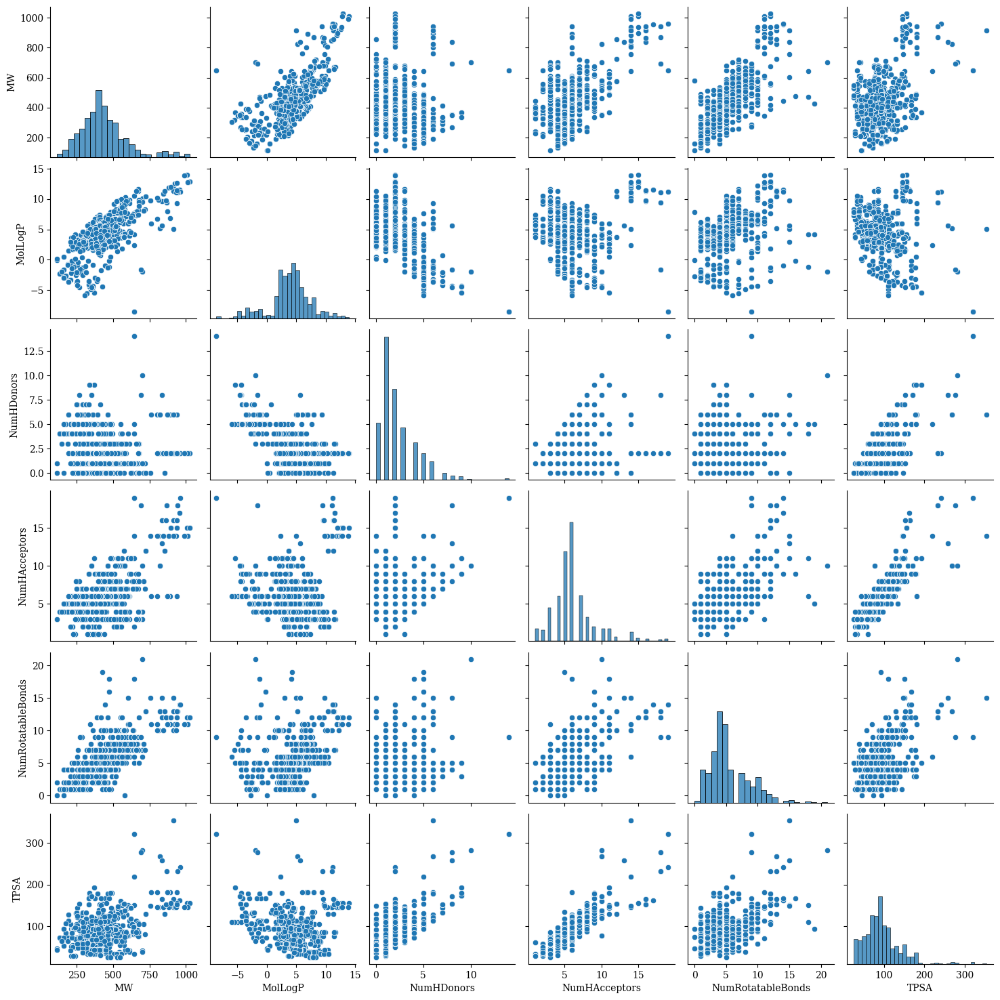

In [5]:
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
 
sns.pairplot(df[Descriptors_list])

In [9]:
# 聚类分析
# 通过Morgan指纹和Tanimoto系数进行相似性评估
# `DataStructs`和`AllChem`模块是从RDKit化学信息学库导入的，分别用于处理数据结构（如分子指纹）和执行化学计算（如生成Morgan指纹）。
# `numpy`是Python中用于科学计算的核心库，提供高效的多维数组对象和相关操作。
from rdkit import DataStructs
from rdkit.Chem import AllChem
import numpy as np

# 从`df_new`数据框中提取“ROMol”列，该列预期包含RDKit分子对象。`df_new`是一个pandas DataFrame，
# 其中“ROMol”列存储了分子的RDKit表示，这是一种在化学信息学中常用的表示分子结构的方式。
# `list(df_new['ROMol'])`将这一列的值转换成一个列表，列表中的每个元素都是一个RDKit分子对象。
# 这个列表被命名为`mol_list`，将用于后续的化学分析。
mol_list = list(df_new['ROMol'])

# 打印出`mol_list`列表的长度，即包含的分子数量。
# 这是一个检查点，用于确认我们正确提取了分子数据，并得到了预期数量的分子。
# 在进行后续的分析步骤之前，了解数据集的规模是一个好习惯。
print(len(mol_list))

756


In [10]:
# 使用RDKit库生成摩根指纹（Morgan fingerprints），这是一种用于表示分子结构的指纹。
# 摩根指纹通过考虑分子中原子的连接方式和它们的化学环境来编码分子信息。
# 这一行代码遍历`mol_list`列表（预期包含RDKit分子对象），
# 并为列表中的每个分子生成一个固定大小（2048位）的摩根指纹，半径设置为2。
# 这些指纹被收集到一个名为`morgan_fp`的列表中。
morgan_fp = [AllChem.GetMorganFingerprintAsBitVect(x, 2, 2048) for x in mol_list]

# 计算列表中前756个分子（由`morgan_fp[:756]`指定）与列表中每个分子（由循环索引`i`指定）
# 的相似度，使用的是Tanimoto相似度指标。Tanimoto相似度是化学信息学中用于量化两个分子指纹
# 之间相似性的常用方法。
# `BulkTanimotoSimilarity`函数计算一个分子指纹与一组分子指纹之间的相似度，
# 并且可以通过设置`returnDistance=True`来返回“距离”（1 - 相似度）而不是相似度本身。
# 这段代码创建了一个包含756个元素的列表`dis_matrix`，每个元素都是一个列表，
# 表示单个分子与前756个分子的距离（或相似度）。
dis_matrix = [DataStructs.BulkTanimotoSimilarity(morgan_fp[i], morgan_fp[:756], returnDistance=True) for i in range(756)]

# 将`dis_matrix`列表转换为NumPy数组`dis_array`。这使得后续对数组的操作更为方便，
# 例如数学运算、形状变换或与其他科学计算库的集成等。
# `dis_array`是一个二维数组，其中的每个元素表示一个分子与前756个分子的距离。
dis_array = np.array(dis_matrix)

# 输出`dis_array`的形状（维度）。这通常用于验证数组的大小和形状是否符合预期。
# 在这个例子中，预期`dis_array`的形状是(756, 756)，因为我们计算了756个分子与前756个分子之间的距离，
# 即每个分子与其他756个分子（包括它自己）的距离。
dis_array.shape


(756, 756)

In [11]:
# 通过K均值聚类
from sklearn.cluster import KMeans
import pandas as pd
 
kmeans = KMeans(n_clusters=2, n_init=10)
kmeans.fit(dis_array)
pd.value_counts(kmeans.labels_)

0    523
1    233
Name: count, dtype: int64

In [12]:
print(len(kmeans.labels_))
print(len(df_new))

756
756


In [13]:
class_list = []
for i in range(len(kmeans.labels_)):
    if kmeans.labels_[i] == 0:
        class_list.append('class_0')
    elif kmeans.labels_[i] == 1:
        class_list.append('class_1')
        
df_new['kmeans_class'] = class_list

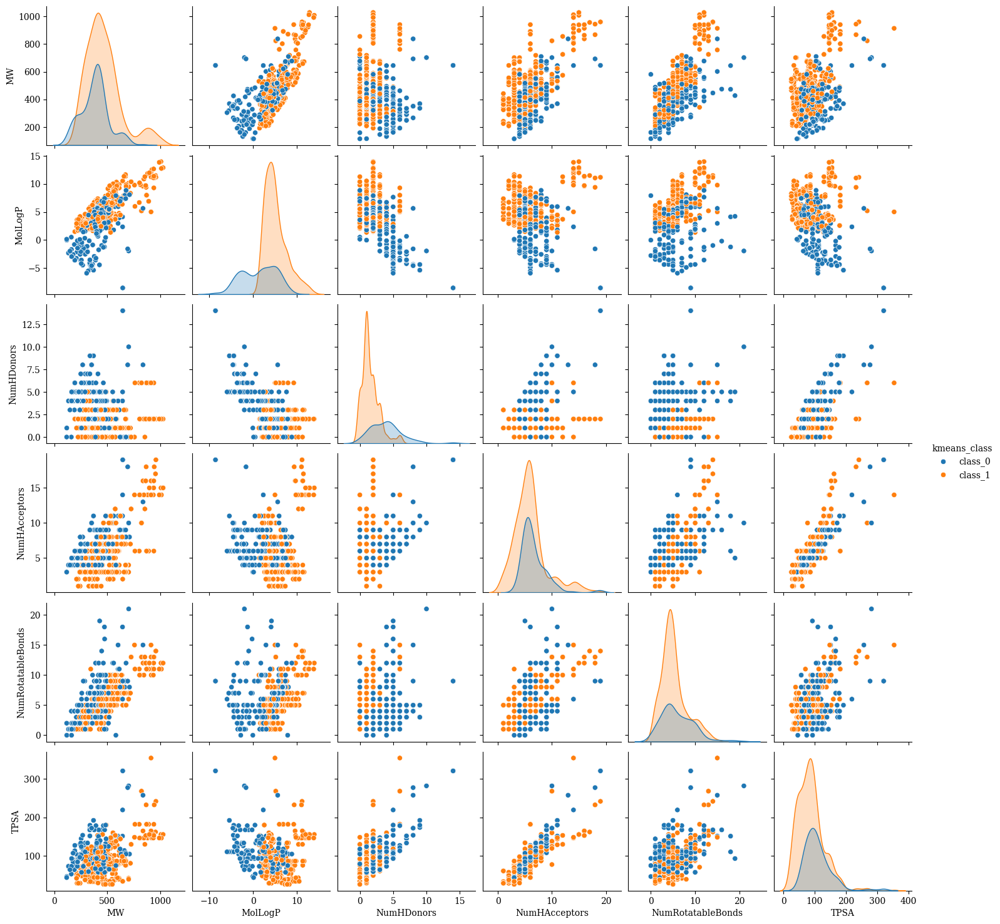

In [14]:
Descriptors_class = ['MW', 'MolLogP', 'NumHDonors', 'NumHAcceptors', 'NumRotatableBonds', 'TPSA', 'kmeans_class']
sns.pairplot(df_new[Descriptors_class], hue='kmeans_class')

In [15]:
import mpld3
from mpld3 import plugins
mpld3.enable_notebook()
 
from rdkit.Chem.Draw import rdMolDraw2D
from IPython.display import SVG
 
svgs_list = []
 
 
for i in range(len(df_new)):
    view = rdMolDraw2D.MolDraw2DSVG(300,300)
    
    ROMol_col = df_new.columns.get_loc('ROMol')
    
    mol = df_new.iloc[i, ROMol_col]
    
    prepro_mol = rdMolDraw2D.PrepareMolForDrawing(mol)
    
    view.DrawMolecule(prepro_mol)
    
    view.FinishDrawing()
    
    svg = view.GetDrawingText()
    
    svgs_list.append(svg.replace('svg:,',''))

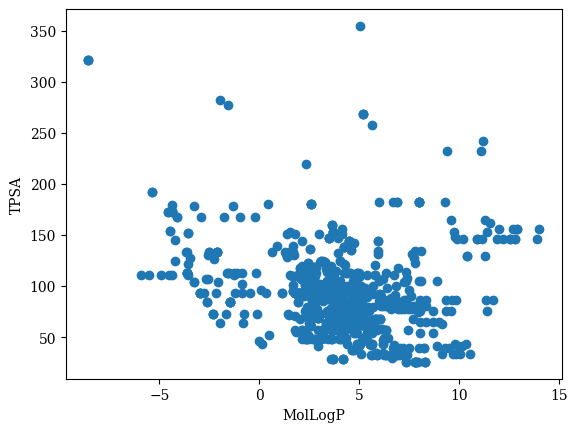

In [16]:
fig, ax = plt.subplots()
ax.set_xlabel('MolLogP')
ax.set_ylabel('TPSA')
points = ax.scatter(df_new['MolLogP'], df_new['TPSA'])
 
tooltip = plugins.PointHTMLTooltip(points, svgs_list)
plugins.connect(fig, tooltip)

In [17]:
df_class_0 = df_new[df_new['kmeans_class']== 'class_0']
class_0_list = list(df_class_0['ROMol'])
 
df_class_1 = df_new[df_new['kmeans_class']== 'class_1']
class_1_list = list(df_class_1['ROMol'])

In [18]:
from ipywidgets import interact,fixed,IntSlider
import ipywidgets
 
def class_0_viewer(idx):
    mol = class_0_list[idx]
    return(display(Draw.MolToImage(mol)))
    
interact(class_0_viewer, idx=ipywidgets.IntSlider(min=0,max=len(class_0_list)-1, step=1));

interactive(children=(IntSlider(value=0, description='idx', max=522), Output()), _dom_classes=('widget-interac…

In [19]:
df_peptides = pd.concat([df_class_1, df_class_0.iloc[[29,30,32]]])
df_small_molecules = df_class_0.drop([40,41,43])
 
print(len(df_peptides))
print(len(df_small_molecules))

236
520
